# Особенности заведений московского общепита

<b>Описание проекта:</b>

Фонд 'Shut Up and Take My Money' ищет возможности в сфере общепита Москвы.<br>
Решение об объёмах и формате инвестиций будет приниматься на основе анализа датасета 'moscow_places.csv', в котором содержится информация о рынке московского общепита.

<b>Цели:</b>

- Определить ключевые особенности для различных форматов заведений общепита.<br>
- Обозначить возможные направления развития и потенциальные точки роста.

<b>Шаги исследования:</b>

1. Обзор данных<br>
2. Предобработка данных<br>
3. Исследование данных<br>
4. Анализ сегмента кофеен<br>
5. Подготовка презентации<br>
6. Оформление

In [2]:
!pip install folium

Defaulting to user installation because normal site-packages is not writeable


In [3]:
# импорт библиотек
import json
import pandas as pd
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt
%matplotlib inline
from plotly import graph_objects as go
import warnings
import seaborn as sns
import folium
from folium import Map, Choropleth, Marker
from folium.plugins import MarkerCluster
pd.options.mode.chained_assignment = None
warnings.filterwarnings('ignore')

In [4]:
try:
    # local path
    data = pd.read_csv('moscow_places.csv')
    state_geo = 'admin_level_geomap.geojson'

except:
    # Yandex path
    data = pd.read_csv('/datasets/moscow_places.csv')
    state_geo = '/datasets/admin_level_geomap.geojson'


## Обзор данных

Оценим информацию в датасете

In [5]:
data.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


Информация в датасете распределена по колонкам:<br>
- <b>name</b> — название заведения;
- <b>address</b> — адрес заведения;
- <b>category</b> — категория заведения, например «кафе», «пиццерия» или «кофейня»;
- <b>hours</b> — информация о днях и часах работы;
- <b>lat</b> — широта географической точки, в которой находится заведение;
- <b>lng</b> — долгота географической точки, в которой находится заведение;
- <b>rating</b> — рейтинг заведения по оценкам пользователей в Яндекс Картах (высшая оценка — 5.0);
- <b>price</b> — категория цен в заведении, например «средние», «ниже среднего», «выше среднего» и так далее;
- <b>avg_bill</b> — строка, которая хранит среднюю стоимость заказа в виде диапазона<br>
- <b>middle_avg_bill</b> — число с оценкой среднего чека
- <b>middle_coffee_cup</b> — число с оценкой одной чашки капучино
- <b>chain</b> — число, выраженное 0 или 1, которое показывает, является ли заведение сетевым
- <b>district</b> — административный район, в котором находится заведение
- <b>seats</b> — количество посадочных мест.

Оценим заголовки колонок:

In [6]:
display([i for i in data.columns])

['name',
 'category',
 'address',
 'district',
 'hours',
 'lat',
 'lng',
 'rating',
 'price',
 'avg_bill',
 'middle_avg_bill',
 'middle_coffee_cup',
 'chain',
 'seats']

Формат заголовков соответствует требованиям к формату, изменения не требуются

Оценим общую информацию о датасете:

- В датасете 8406 строк и 14 колонок
- Типы данных: дробные числа, целые числа и строки

In [7]:
print('Оценим количество пропусков')
data.isna().sum()

Оценим количество пропусков


name                    0
category                0
address                 0
district                0
hours                 536
lat                     0
lng                     0
rating                  0
price                5091
avg_bill             4590
middle_avg_bill      5257
middle_coffee_cup    7871
chain                   0
seats                3611
dtype: int64

Датасет содержит данные разных типов, также в нём присутствуют пропуски.<br>

Проверим датасет на явные дубликаты:

In [8]:
data.duplicated().sum()

0

Далее каждый из столбцов оценим отдельно:

## Предобработка данных

### <b>name</b>

- Столбец содержит информацию о названии заведения.<br>
- Из первичного обзора видно, что в названиях используются оба регистра.<br>
- Приведём названия точек к нижнему регистру<br>

In [9]:
print(f'Количество уникальных наименований в разных регистрах: {len(data["name"].unique())}')
print(f'Количество уникальных наименований в нижнем регистре: {len(data["name"].str.lower().unique())}')
print(f'Разница: {len(data["name"].unique()) - len(data["name"].str.lower().unique())}')

Количество уникальных наименований в разных регистрах: 5614
Количество уникальных наименований в нижнем регистре: 5512
Разница: 102


In [10]:
data['name'] = data['name'].str.lower()

### <b>category

Выведем уникальные названия категорий:

In [11]:
print([i for i in sorted(data['category'].unique())])

['бар,паб', 'булочная', 'быстрое питание', 'кафе', 'кофейня', 'пиццерия', 'ресторан', 'столовая']


В колонке category содержатся корректные данные, не требующие форматирования.

### <b>address

In [12]:
data['address'].head()

0             Москва, улица Дыбенко, 7/1
1     Москва, улица Дыбенко, 36, корп. 1
2         Москва, Клязьминская улица, 15
3    Москва, улица Маршала Федоренко, 12
4        Москва, Правобережная улица, 1Б
Name: address, dtype: object

Приведём все данные к строчному формату, чтобы избежать неочевидных дубликатов

In [13]:
data['address'] = data['address'].str.lower()

Формат адреса позволяет с помощью метода split() создать новую колонку с названием улицы.

In [14]:
data['street'] = data['address'].apply(lambda x: x.split(',')[1])

Визуально определим возможные неявные дубликаты

In [15]:
for i in sorted(data['street'].unique()):
    print(i)

 1-й автозаводский проезд
 1-й балтийский переулок
 1-й варшавский проезд
 1-й вешняковский проезд
 1-й волоколамский проезд
 1-й голутвинский переулок
 1-й грайвороновский проезд
 1-й дербеневский переулок
 1-й дорожный проезд
 1-й земельный переулок
 1-й капотнинский проезд
 1-й кирпичный переулок
 1-й колобовский переулок
 1-й котляковский переулок
 1-й красногвардейский проезд
 1-й курьяновский проезд
 1-й лучевой просек
 1-й магистральный тупик
 1-й нагатинский проезд
 1-й неопалимовский переулок
 1-й николощеповский переулок
 1-й новокузнецкий переулок
 1-й обыденский переулок
 1-й переулок тружеников
 1-й проезд перова поля
 1-й рижский переулок
 1-й самотёчный переулок
 1-й сетуньский проезд
 1-й силикатный проезд
 1-й спасоналивковский переулок
 1-й стрелецкий проезд
 1-й тверской-ямской переулок
 1-й хорошёвский проезд
 1-й щипковский переулок
 1-я боевская улица
 1-я брестская улица
 1-я владимирская улица
 1-я дубровская улица
 1-я квесисская улица
 1-я курьяновская улица
 

- Удалим улицу "№ 7",
- "улицу Шкулёва 4" переименуем в "улицу Шкулёва"
- Топонимы с элементами 'ул.' и 'пр-т' переименуем в 'улицу' и 'проспект'.
- Заменим букву 'ё' на 'е'

In [16]:
data['street'] = data['street'].replace({'ё': 'e',
                        'улица шкулева 4': 'улица шкулева',
                        'пр-т комсомольский': 'комсомольский проспект', 
                        'ул. профсоюзная': 'улица профсоюзная',
                        'ул. ярославская': 'улица ярославская', 
                          'Восточный административный округ': 'вао', 
                          'Юго-Восточный административный округ': 'ювао', 
                          'Южный административный округ': 'юао',
                          'Юго-Западный административный округ': 'юзао'})

In [17]:
data = data[~data['street'].str.contains('№ 7')]

Оценим сохранённые данные:

In [18]:
for i in sorted(data['street'].unique()):
    print(i)

 1-й автозаводский проезд
 1-й балтийский переулок
 1-й варшавский проезд
 1-й вешняковский проезд
 1-й волоколамский проезд
 1-й голутвинский переулок
 1-й грайвороновский проезд
 1-й дербеневский переулок
 1-й дорожный проезд
 1-й земельный переулок
 1-й капотнинский проезд
 1-й кирпичный переулок
 1-й колобовский переулок
 1-й котляковский переулок
 1-й красногвардейский проезд
 1-й курьяновский проезд
 1-й лучевой просек
 1-й магистральный тупик
 1-й нагатинский проезд
 1-й неопалимовский переулок
 1-й николощеповский переулок
 1-й новокузнецкий переулок
 1-й обыденский переулок
 1-й переулок тружеников
 1-й проезд перова поля
 1-й рижский переулок
 1-й самотёчный переулок
 1-й сетуньский проезд
 1-й силикатный проезд
 1-й спасоналивковский переулок
 1-й стрелецкий проезд
 1-й тверской-ямской переулок
 1-й хорошёвский проезд
 1-й щипковский переулок
 1-я боевская улица
 1-я брестская улица
 1-я владимирская улица
 1-я дубровская улица
 1-я квесисская улица
 1-я курьяновская улица
 

### <b>district

Оценим данные:

In [19]:
data['district'].unique()

array(['Северный административный округ',
       'Северо-Восточный административный округ',
       'Северо-Западный административный округ',
       'Западный административный округ',
       'Центральный административный округ',
       'Восточный административный округ',
       'Юго-Восточный административный округ',
       'Южный административный округ',
       'Юго-Западный административный округ'], dtype=object)

Нужно привести к нижнему регистру, но данный формат используется в дальнейшем в json файле, по которому строится хороплет.<br>Оставляем без именений

### <b>hours

Колонка содержит данные с режимом работы. Оценим данные:

In [20]:
len(data['hours'].unique())

1308

Столбец содержит 1308 вариантов режима работы. <br>Нам интересна исключительно парадигма 'круглосуточно: да/нет'.

На основании данных из этой колонки создадим новый признак: 'is_24_7'(True/False).

<b>Создадим столбец 'is_24_7'

In [21]:
data['is_24_7'] = data['hours'].apply(lambda x: True if x == 'ежедневно, круглосуточно' else False)

Проверим:

In [22]:
data['is_24_7'].unique()

array([False,  True])

### lat & lng

In [23]:
data['lat'].head()

0    55.878494
1    55.875801
2    55.889146
3    55.881608
4    55.881166
Name: lat, dtype: float64

In [24]:
data['lng'].head()

0    37.478860
1    37.484479
2    37.525901
3    37.488860
4    37.449357
Name: lng, dtype: float64

Столбцы с широтой и долготой.<br> Предварительно, не требуют корректировки

### rating

Рейтинг заведения в формате float

In [25]:
data['rating'].unique()

array([5. , 4.5, 4.6, 4.4, 4.7, 4.8, 4.3, 4.9, 4.2, 4.1, 4. , 3.8, 3.9,
       3.7, 3.6, 2.8, 2.7, 3.1, 1.5, 2. , 1.4, 3.3, 3.5, 3.2, 2.9, 3. ,
       3.4, 2.3, 2.2, 2.5, 2.6, 1.7, 1. , 1.1, 2.4, 1.3, 1.2, 2.1, 1.8,
       1.9, 1.6])

Пропуски отсутствуют

In [26]:
data['rating'].isna().sum()

0

### chain

In [27]:
data['chain'].unique()

array([0, 1])

Принадлежность заведения к сетевым точкам общественного питания

### seats

Информация о посадочных местах в заведениях.

In [28]:
data['seats'].describe()

count    4795.000000
mean      108.421689
std       122.833396
min         0.000000
25%        40.000000
50%        75.000000
75%       140.000000
max      1288.000000
Name: seats, dtype: float64

In [29]:
len(data['seats'])

8405

In [30]:
data['seats'].isna().sum()

3610

У 3610 объектов отсутствует информация о количестве посадочных мест

In [31]:
data[data['seats'].isna()]['category'].value_counts()

кафе               1159
ресторан            773
кофейня             662
бар,паб             297
быстрое питание     254
пиццерия            206
столовая            151
булочная            108
Name: category, dtype: int64

Для упрощения работы, все Nan в ['seats'] заменим на -1

Посмотрим, есть ли выбросы в данных по посадочным местам

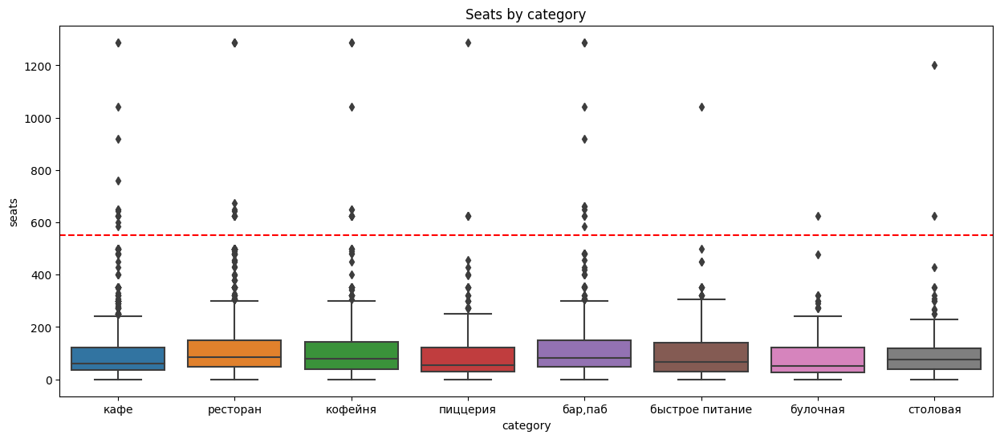

In [32]:
plt.figure(figsize=(15, 6))
plt.title('Seats by category')
plt.axhline(y=550, color='r', linestyle='--')
sns.boxplot(data=data, x='category', y='seats');

Как видно из диаграммы выше, выбросами можно считать все значения выше 550 посадочных мест.<br>

Посчитаем, какое количество заведений окажутся среди |тех, которые превышают порог:

In [33]:
len(data[data['seats'] > 550])

56

Таких заведений совсем немного, на выборку они влиять не будут. Можно их удалить позднее, после заполнения пропусков по количеству посадочных мест.

Заполним пропуски в столбце с данными по посадочным местам медианой

In [34]:
data.seats.fillna(data.groupby('category')['seats'].transform('median'),inplace=True)

In [35]:
data['seats'].describe()

count    8405.000000
mean       92.564307
std        94.882162
min         0.000000
25%        55.000000
50%        75.500000
75%        86.000000
max      1288.000000
Name: seats, dtype: float64

In [36]:
data['seats'].isna().sum()

0

Удалим все объекты, с количеством посадочных мест более 550 (выбросы)

In [37]:
data = data[data['seats'] <= 550]

проверим результат:

In [38]:
data[data['seats'].isna()]['category'].value_counts()

Series([], Name: category, dtype: int64)

In [39]:
data.info();

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8349 entries, 0 to 8405
Data columns (total 16 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8349 non-null   object 
 1   category           8349 non-null   object 
 2   address            8349 non-null   object 
 3   district           8349 non-null   object 
 4   hours              7821 non-null   object 
 5   lat                8349 non-null   float64
 6   lng                8349 non-null   float64
 7   rating             8349 non-null   float64
 8   price              3294 non-null   object 
 9   avg_bill           3792 non-null   object 
 10  middle_avg_bill    3131 non-null   float64
 11  middle_coffee_cup  529 non-null    float64
 12  chain              8349 non-null   int64  
 13  seats              8349 non-null   float64
 14  street             8349 non-null   object 
 15  is_24_7            8349 non-null   bool   
dtypes: bool(1), float64(6), 

### price, avg_bill, middle_avg_bill, middle_coffee_cup

В данных колонках содержится некоторая информация о сегменте заведения, среднем чеке и стоимости чашки кофе.

#### <b> middle_coffee_cup

Предположительно, данный показатель относится исключительно к кафе и кофейням.<br>
Оценим общие данные<br>
Отфильтруем датасет по данному показателю и категории заведения

In [40]:
data[data['middle_coffee_cup'] >= 0]['category'].value_counts()

кофейня            515
бар,паб              6
кафе                 4
пиццерия             3
быстрое питание      1
Name: category, dtype: int64

In [41]:
data['middle_coffee_cup'].describe()

count     529.000000
mean      174.725898
std        89.225235
min        60.000000
25%       125.000000
50%       169.000000
75%       225.000000
max      1568.000000
Name: middle_coffee_cup, dtype: float64

Посмотрим на выбросы:

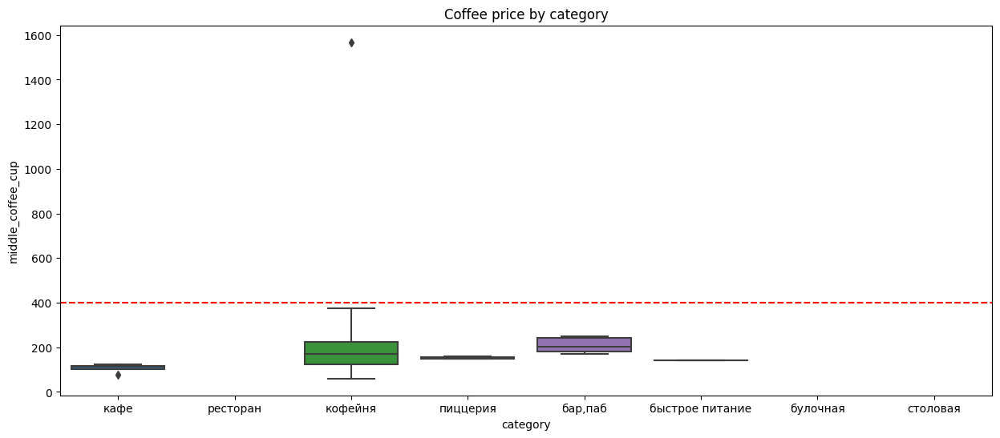

In [42]:
plt.figure(figsize=(15, 6))
plt.title('Coffee price by category')
plt.axhline(y=400, color='r', linestyle='--')
sns.boxplot(data=data, x='category', y='middle_coffee_cup');

Аномальным чеком за чашку кофе будем считать цену более 400р

Как видно из таблицы выше, предположение оказалось верным.

Посмотрим, сколько заведений из данной категории имеют пропуски в столбце 'middle_coffee_cup'

In [43]:
len(data[(data['category'] == 'кофейня') & (data['middle_coffee_cup'].isna())])

886

In [44]:
data.loc[(data['category']== 'кофейня') & (data['middle_coffee_cup'].isna()), 'middle_coffee_cup'] = data.loc[(data['category']== 'кофейня'), 'middle_coffee_cup'].median()

In [45]:
len(data[(data['category'] == 'кофейня') & (data['middle_coffee_cup'].isna())])

0

Оценим количество заведений с чеком за кофе более 400р

In [46]:
data[data['middle_coffee_cup'] > 400]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
2859,шоколадница,кофейня,"москва, большая семёновская улица, 27, корп. 1",Восточный административный округ,"ежедневно, 08:00–23:00",55.782268,37.709022,4.2,средние,Цена чашки капучино:230–2907 ₽,NaN,1568.0,1,48.0,большая семёновская улица,False


Это заведение сети Шоколадница, и, скорее всего, в средний чек закралась ошибка: максимальная стоимость чашки капучино увеличена в 10раз

Это подтверждают и данные по другим кофейням сети с медианой в 220р

In [47]:
data[data['name'] == 'шоколадница']['middle_coffee_cup'].median()

220.0

Заменим значение на медиану:

In [48]:
data.loc[(data['name']== 'шоколадница') & (data['middle_coffee_cup'] == 1568), 'middle_coffee_cup'] = data.loc[(data['name']== 'шоколадница'), 'middle_coffee_cup'].median()

#### price

In [49]:
data[data['price'].isna()]['category'].value_counts()

кафе               1732
ресторан           1020
кофейня             929
быстрое питание     412
пиццерия            321
бар,паб             266
булочная            214
столовая            161
Name: category, dtype: int64

Посмотрим на распределение по категориям пропусков по колонке price (ценовой сегмент)

In [50]:
data[data['price'].isna()]['category'].value_counts()

кафе               1732
ресторан           1020
кофейня             929
быстрое питание     412
пиццерия            321
бар,паб             266
булочная            214
столовая            161
Name: category, dtype: int64

Оценим все категории в разрезе ценового сегмента(price):

In [51]:
for item in data['category'].unique():
    print(f'Распределение по сегментам для категории {item}:')
    print(data[data['category']==item]['price'].value_counts())
    print()

Распределение по сегментам для категории кафе:
средние          498
выше среднего     77
высокие           30
низкие            26
Name: price, dtype: int64

Распределение по сегментам для категории ресторан:
средние          457
высокие          268
выше среднего    265
низкие            21
Name: price, dtype: int64

Распределение по сегментам для категории кофейня:
средние          374
низкие            67
высокие           17
выше среднего     14
Name: price, dtype: int64

Распределение по сегментам для категории пиццерия:
средние          235
выше среднего     39
высокие           30
низкие             4
Name: price, dtype: int64

Распределение по сегментам для категории бар,паб:
средние          215
выше среднего    152
высокие          120
низкие             2
Name: price, dtype: int64

Распределение по сегментам для категории быстрое питание:
средние          160
низкие            22
выше среднего      5
высокие            3
Name: price, dtype: int64

Распределение по сегментам 

Категориям 'быстрое питание', 'столовая', 'булочная', 'быстрое питание', 'пиццерия', 'кафе', 'кофейня':
присвоим сегмент 'средние', поскольку данный сегмент преобладает в категории.

In [52]:
mid_price_cat = ['быстрое питание', 'столовая', 'булочная', 'быстрое питание', 'пиццерия', 'кафе', 'кофейня']

In [53]:
for item in mid_price_cat:
    data.loc[(data['category'] == item) & (data['price'].isna()), 'price'] = 'средние'

Оценим изменения: остались пропуски в двух категориях - 'ресторан' и 'бар,паб'

In [54]:
data[data['price'].isna()]['category'].value_counts()

ресторан    1020
бар,паб      266
Name: category, dtype: int64

Данные пропуски заполним на основании сопоставления сегмента и среднего чека у других ресторанов.<br>
Возьмём первые 5 значений.

In [55]:
data['price'].unique()

array(['средние', 'выше среднего', nan, 'высокие', 'низкие'], dtype=object)

In [56]:
data[(data['category'] == 'ресторан')&(data['price'] == 'высокие')]['avg_bill'].value_counts()[:5]

Средний счёт:1500–2000 ₽    54
Средний счёт:1500–2500 ₽    32
Средний счёт:2000–2500 ₽    26
Средний счёт:2500–3000 ₽    12
Средний счёт:2000 ₽         10
Name: avg_bill, dtype: int64

In [57]:
data[(data['category'] == 'ресторан')&(data['price'] == 'выше среднего')]['avg_bill'].value_counts()[:5]

Средний счёт:1000–1500 ₽    103
Средний счёт:от 1500 ₽       28
Средний счёт:1000–2000 ₽     20
Средний счёт:1500 ₽          19
Средний счёт:1200–1500 ₽     11
Name: avg_bill, dtype: int64

Как видим, в сегменты с высокими ценами попадают рестораны со средним чеком от 1500Р

In [58]:
data[(data['category'] == 'ресторан')&(data['price'] == 'средние')]['avg_bill'].value_counts()[:5]

Средний счёт:500–1000 ₽    14
Средний счёт:300–500 ₽     13
Средний счёт:до 1000 ₽     13
Средний счёт:300 ₽         12
Средний счёт:500–1500 ₽    12
Name: avg_bill, dtype: int64

Средний чек от 300 до 1500 Р - это средний сегмент.

Посмотрим, какой средний чек у ресторанов с пропусками в сегменте:

In [59]:
data[(data['category'] == 'ресторан')&(data['price'].isna())]['avg_bill'].value_counts()[:5]

Средний счёт:1000–1500 ₽    17
Средний счёт:200–400 ₽       6
Средний счёт:300–500 ₽       4
Средний счёт:500–1000 ₽      3
Средний счёт:250–350 ₽       2
Name: avg_bill, dtype: int64

Заполним пропуски для данной категории:

In [60]:
data.loc[(data['category'] == 'ресторан') & (data['price'].isna()), 'price'] = 'средние'

Проверим изменения:

In [61]:
data[data['price'].isna()]['category'].value_counts()

бар,паб    266
Name: category, dtype: int64

Без сегмента остались только бары:

Оценим распределение по сегментам в зависиомти от чека:

In [62]:
data[(data['category'] == 'бар,паб')&(data['price'] == 'средние')]['avg_bill'].value_counts()

Средний счёт:1000–1200 ₽      16
Средний счёт:1000 ₽           15
Средний счёт:до 1000 ₽        11
Средний счёт:700–1000 ₽        6
Средний счёт:800–1200 ₽        5
                              ..
Средний счёт:400–700 ₽         1
Цена бокала пива:90–250 ₽      1
Цена бокала пива:180–260 ₽     1
Средний счёт:250–400 ₽         1
Цена бокала пива:от 140 ₽      1
Name: avg_bill, Length: 118, dtype: int64

In [63]:
data[(data['category'] == 'бар,паб')&(data['price'] == 'высокие')]['avg_bill'].value_counts()[:20]

Средний счёт:1500–2000 ₽      31
Средний счёт:1500–2500 ₽      16
Средний счёт:2000–2500 ₽       7
Средний счёт:1500–3000 ₽       4
Средний счёт:2500 ₽            3
Средний счёт:от 2500 ₽         3
Средний счёт:1000–2500 ₽       2
Средний счёт:2000 ₽            2
Средний счёт:2000–3000 ₽       2
Средний счёт:от 2000 ₽         2
Средний счёт:2500–3000 ₽       1
Цена бокала пива:до 350 ₽      1
Средний счёт:4500–5000 ₽       1
Средний счёт:2400 ₽            1
Цена бокала пива:250–395 ₽     1
Средний счёт:2500–5000 ₽       1
Средний счёт:1500–3500 ₽       1
Средний счёт:3000–5000 ₽       1
Цена бокала пива:250–390 ₽     1
Цена бокала пива:350 ₽         1
Name: avg_bill, dtype: int64

In [64]:
data[(data['category'] == 'бар,паб')&(data['price'].isna())]['avg_bill'].value_counts()[:10]

Средний счёт:1000–1200 ₽      3
Цена бокала пива:300 ₽        2
Цена бокала пива:370–420 ₽    1
Средний счёт:250–500 ₽        1
Цена бокала пива:250–550 ₽    1
Средний счёт:100–300 ₽        1
Средний счёт:от 600 ₽         1
Цена бокала пива:250–450 ₽    1
Цена бокала пива:до 350 ₽     1
Средний счёт:700 ₽            1
Name: avg_bill, dtype: int64

Очень неоднозначные данные по среднему чеку: за основу берётся и общий средний чек и стоимость кружки пива.<br>Разброс в ценах позволяет все пропуски в данной категории заполнить значением 'средние'

In [65]:
data.loc[(data['category'] == 'бар,паб') & (data['price'].isna()), 'price'] = 'средние'

In [66]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8349 entries, 0 to 8405
Data columns (total 16 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8349 non-null   object 
 1   category           8349 non-null   object 
 2   address            8349 non-null   object 
 3   district           8349 non-null   object 
 4   hours              7821 non-null   object 
 5   lat                8349 non-null   float64
 6   lng                8349 non-null   float64
 7   rating             8349 non-null   float64
 8   price              8349 non-null   object 
 9   avg_bill           3792 non-null   object 
 10  middle_avg_bill    3131 non-null   float64
 11  middle_coffee_cup  1415 non-null   float64
 12  chain              8349 non-null   int64  
 13  seats              8349 non-null   float64
 14  street             8349 non-null   object 
 15  is_24_7            8349 non-null   bool   
dtypes: bool(1), float64(6), 

#### middle_avg_bill

Заполним пропуски в данном столбце медианами категорий:

In [67]:
categories_mid_avg_bill = data['category'].unique()

In [68]:
for category in categories_mid_avg_bill:
    data.loc[(data['category']== category) & (data['middle_avg_bill'].isna()), 'middle_avg_bill'] = data.loc[(data['category'] == category), 'middle_avg_bill'].median()

In [69]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8349 entries, 0 to 8405
Data columns (total 16 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8349 non-null   object 
 1   category           8349 non-null   object 
 2   address            8349 non-null   object 
 3   district           8349 non-null   object 
 4   hours              7821 non-null   object 
 5   lat                8349 non-null   float64
 6   lng                8349 non-null   float64
 7   rating             8349 non-null   float64
 8   price              8349 non-null   object 
 9   avg_bill           3792 non-null   object 
 10  middle_avg_bill    8349 non-null   float64
 11  middle_coffee_cup  1415 non-null   float64
 12  chain              8349 non-null   int64  
 13  seats              8349 non-null   float64
 14  street             8349 non-null   object 
 15  is_24_7            8349 non-null   bool   
dtypes: bool(1), float64(6), 

Пропуски в колонке avg_bill заполнять не будем, за основу возьмем данные из столбца middle_avg_bill

Столбец middle_coffee_cup также оставим с пропусками, поскольку, в основном данная информация относится к формату кофеен и носит дополнительный характер.

## Анализ данных

### Обзор категорий общепита

#### Распределение по категориям

In [70]:
food_industry_by_ctg = (data.groupby(['category'])
                        .agg({'category':'count'})
                        .rename(columns={'category':'ctg_count'})
                        .sort_values(by='ctg_count', ascending=False)
                       )
food_industry_by_ctg = food_industry_by_ctg.reset_index()
display(food_industry_by_ctg)

,category,ctg_count
0,кафе,2363
1,ресторан,2031
2,кофейня,1401
3,"бар,паб",755
4,пиццерия,629
5,быстрое питание,602
6,столовая,313
7,булочная,255


In [71]:
layout=go.Layout(
    title='Food industry by categories'
)
fig = go.Figure(data=[go.Pie(labels=food_industry_by_ctg['category'],
                             values=food_industry_by_ctg['ctg_count'])], 
                layout=layout)

fig.show() 

Самые распространённые форматы - кафе, ресторан и кофейня.<br>
На кафе и кофейни приходится более 40% всех заведений: эти формат требует меньше вложений на старте (по сравнению с рестораном), однако, возможно, их уже слишком много.

#### Посадочные места

Посмотрим на то, как распределяются посадочные места по категориям заведений.<br>
Для понимания сравнения добавим на график медиану, равняющуюся 75.

In [72]:
print(data['seats'].median())

75.5


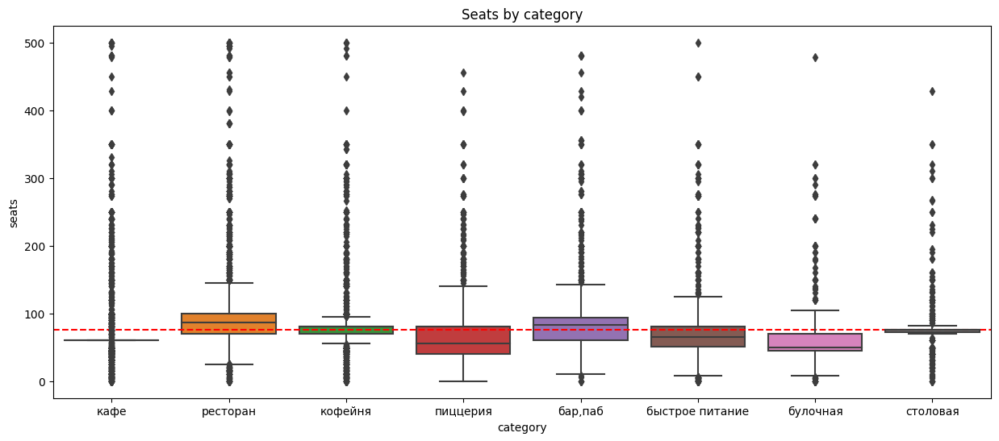

In [73]:
plt.figure(figsize=(15, 6))
plt.title('Seats by category')
plt.axhline(y=data['seats'].median(), color='r', linestyle='--')

sns.boxplot(data=data, x='category', y='seats');

Как видно из графика, показатель посадочных мест крайне вариативен, особо отличаются категории кафе, кофейня и столовая: здесь можно найти заведения с любым количеством мест.<br>
Остальные категории в значительно большей степени тяготеют к медиане в 75 посадочных мест.<br>

Исходя из вышесказанного: наиболее "гибкие форматы": кафе, кофейня и столовая.<br> Запуск данных категорий возможен и при минимальном количестве посадочных мест, а значит с минимальными стартовыми инвестициями<br>
Если планируется запуск иной категории - ориентируемся на медиану в 75 мест.

#### Сети и категории

Оценим соотношение сетевых и несетевых заведений:

In [74]:
industry_by_chain = (data.groupby(['chain'])
                        .agg({'chain':'count'})
                        .rename(columns={'chain':'chn_count'})
                        .sort_values(by='chn_count', ascending=False)
                       )
industry_by_chain = industry_by_chain.reset_index()

In [75]:
layout=go.Layout(
    title='Chain/Non-chain Ratio'
)
labels=['non-chain', 'chain']
fig = go.Figure(data=[go.Pie(labels=labels,
                             values=industry_by_chain['chn_count'])], 
                layout=layout)

fig.show() 

Очевидно, несетевые продавцы преобладают.<br> Однако, вполне вероятно, что доля рынка в денежном выражении будет выглядеть с точностью наоборот.<br> Это связано с тем, что сетевые игроки стремятся открываться на максимальных клиентских потоках. В местах с высокой арендной платой.<br>В то время как несетевые игроки стремятся к нишевым форматам, ориентируясь на локальных потребителей и невысокую аренду.

Посмотрим, как распределяются категории внутри сетей.

In [76]:
chains_by_ctg = data[['category','chain']].groupby('category').agg({'chain':'sum'}).reset_index().sort_values(by='chain',ascending=False)

In [77]:
chains_by_ctg

,category,chain
3,кафе,774
6,ресторан,722
4,кофейня,713
5,пиццерия,328
2,быстрое питание,231
0,"бар,паб",168
1,булочная,156
7,столовая,87


In [78]:
px.bar(chains_by_ctg.reset_index(), 
             x="category",
             y="chain",
             color='category',
             title = "Chains by Category",
             width=1000, 
             height=500)

Сетевые игроки предпочитают форматы кафе, ресторан и кофейня.<br>
Вероятно, кафе и кофейня на старте потребуют меньше вложений, но какую конкуренцию придётся выдержать?<br>Если рядом будет сетевик, лучше ориентироваться на иной формат.<br>
В то же время, это говорит о востребованности подобных форматов, а значит потенциально успешно место, где концентрация сетевых игорков минимальна.

In [79]:
chains_by_name= data[data['chain']==1].groupby('name').agg({'chain':'sum'}).reset_index().sort_values(by='chain',ascending=False)[:15]

In [80]:
chains_by_name

,name,chain
729,шоколадница,118
335,домино'с пицца,76
331,додо пицца,74
146,one price coffee,70
742,яндекс лавка,68
58,cofix,65
168,prime,50
664,хинкальная,44
409,кофепорт,42
418,кулинарная лавка братьев караваевых,38


In [81]:
px.bar(chains_by_name.reset_index(), 
             x="name",
             y="chain",
             color='name',
             title = "Chains by name",
             width=1000, 
             height=700)

Среди сетей безусловный лидер - Шоколадница, далее следуют две пиццерии<br>
Интересно и примечательно, что на 5 месте находится Яндекс Лавка, совсем немного уступая призёрам, которая по сути является Dark Kitchen/Dark Store, работающая исключительно на вынос и не имеющая торгового зала<br>
Формат, который при правильной организации и маркетинге, позволит существенно снизить расходы на старте.<br>

Если же вести речь о традиционных форматах: то сетевики голосуют за кофе и пиццу.

Интересно, а что же там за форматы?

In [82]:
first_15 = list(chains_by_name['name'])

In [83]:
first_15

['шоколадница',
 "домино'с пицца",
 'додо пицца',
 'one price coffee',
 'яндекс лавка',
 'cofix',
 'prime',
 'хинкальная',
 'кофепорт',
 'кулинарная лавка братьев караваевых',
 'теремок',
 'чайхана',
 'cofefest',
 'буханка',
 'му-му']

In [84]:
first15_by_ctg = data[data['name'].isin(first_15)].groupby('category').count().reset_index().sort_values(by='name', ascending=False)

In [85]:
layout=go.Layout(
    title='Top-15 by category'
)
labels=first15_by_ctg['category']
fig = go.Figure(data=[go.Pie(labels=labels,
                             values=first15_by_ctg['name'])], 
                layout=layout)

fig.show()   

Если в бизнес-концепции есть желание создать новый бизнес по модели самых крупных сетевых игроков, то их форматы - кофейня, ресторан и пиццерия<br>
Если же вы планируете развиваться в нише с минимальной конкуренцией со стороны сетей - то нужно смотреть в сторону столовых и баров.<br>
И ещё! Для самых новаторов: Dark Kitchen! Не забывайте, что Яндекс Лавка в топ-5.

In [86]:
data_by_district = data[['district','name','category']]

In [87]:
data_by_district

,district,name,category
0,Северный административный округ,wowфли,кафе
1,Северный административный округ,четыре комнаты,ресторан
2,Северный административный округ,хазри,кафе
3,Северный административный округ,dormouse coffee shop,кофейня
4,Северный административный округ,иль марко,пиццерия
...,...,...,...
8401,Юго-Западный административный округ,суши мания,кафе
8402,Южный административный округ,миславнес,кафе
8403,Юго-Восточный административный округ,самовар,кафе
8404,Юго-Восточный административный округ,чайхана sabr,кафе


In [88]:
data_by_district_grouped = data_by_district.groupby(['district','category']).agg({'name':'count'}).sort_values(by='name', ascending=False)
data_by_district_grouped['total'] = data_by_district_grouped.groupby('district')["name"].transform('sum')
data_by_district_grouped = data_by_district_grouped.sort_values(by='total', ascending=False)
px.bar(data_by_district_grouped.reset_index(), 
             x="district",
             y="name",
             color="category", 
             title = "Districts by categories",
             width=1000, 
             height=800)

В ЦАО заведений очень много. Однако, столовых и булочных не хватает.<br>
Самый малоконкурентный округ - СЗАО: заведений существенно меньше, чем в остальных округах.

#### Рейтинг и хороплет

Создадим таблицу со средним рейтингом заведений и на её основании построим фоновую картограмму.

In [89]:
data_by_rating = data.groupby('district', as_index=False)['rating'].agg('median')

In [90]:
data_by_rating.sort_values(by='rating', ascending=False)

,district,rating
5,Центральный административный округ,4.4
0,Восточный административный округ,4.3
1,Западный административный округ,4.3
2,Северный административный округ,4.3
4,Северо-Западный административный округ,4.3
7,Юго-Западный административный округ,4.3
8,Южный административный округ,4.3
3,Северо-Восточный административный округ,4.2
6,Юго-Восточный административный округ,4.2


In [95]:
#Создаём хороплет
with open('admin_level_geomap.geojson', 'r',encoding='utf-8') as f:
    geo_json = json.load(f)

moscow_lat, moscow_lng = 55.751244, 37.618423
    
m = folium.Map(location=[moscow_lat, moscow_lng], zoom_start=10)
folium.GeoJson(geo_json).add_to(m)
Choropleth(
    geo_data=state_geo,
    data=data_by_rating,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Рейтинг заведений по районам',
).add_to(m);

In [97]:
#Создаём кластер точек с помощью цикла
marker_cluster = MarkerCluster().add_to(m)
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

#применяем функцию create_clusters() к каждой строке датафрейма
data.apply(create_clusters, axis=1)
# выводим карту
m

In [98]:
rating_by_category = data.groupby('category', as_index=False)['rating'].agg({'mean':'mean', 'median':'median'})

Посмотрим на рейтинг в разрезе категорий. Для полноты картины добавим средние значения.

In [99]:
rating_by_category.sort_values(by='median', ascending=False)

,category,mean,median
0,"бар,паб",4.390199,4.4
1,булочная,4.267843,4.3
4,кофейня,4.277373,4.3
5,пиццерия,4.300636,4.3
6,ресторан,4.289808,4.3
7,столовая,4.211821,4.3
2,быстрое питание,4.049834,4.2
3,кафе,4.123656,4.2


Разброс между категориями около 10%, самые высокие категории у баров, булочных и кофеен,<br>
кафе, фастфуд и столовые - среди аутсайдеров.

#### Улицы

In [100]:
data_by_streets = data['street'].value_counts()[:15]

In [101]:
top_15_streets = list(data_by_streets.index)

In [102]:
streets_by_categories = data[data['street'].isin(top_15_streets)].groupby(['street', 'category']).agg({'name':'count'}).sort_values(by='name',ascending=False)
streets_by_categories['total'] = streets_by_categories.groupby('street')['name'].transform('sum')
streets_by_categories = streets_by_categories.sort_values(by='total')

px.bar(streets_by_categories.reset_index(), 
             x='name',
             y='street',
             color='category', 
             title = 'Streets by Category',
             width=900, 
             height=700)

Топ-3 улиц по количеству заведений:<br>
    - Проспект Мира;<br>
    - Профсоюзная ул.;<br>
    - Ленинский пр.;

Найдём улицы, на которых только один объект общепита:

In [103]:
only_inst=data[['street','name']].groupby('street').count().query('name==1').index

In [104]:
list(only_inst)

[' 1-й автозаводский проезд',
 ' 1-й балтийский переулок',
 ' 1-й варшавский проезд',
 ' 1-й вешняковский проезд',
 ' 1-й голутвинский переулок',
 ' 1-й грайвороновский проезд',
 ' 1-й дербеневский переулок',
 ' 1-й земельный переулок',
 ' 1-й капотнинский проезд',
 ' 1-й кирпичный переулок',
 ' 1-й колобовский переулок',
 ' 1-й котляковский переулок',
 ' 1-й курьяновский проезд',
 ' 1-й николощеповский переулок',
 ' 1-й новокузнецкий переулок',
 ' 1-й рижский переулок',
 ' 1-й самотёчный переулок',
 ' 1-й сетуньский проезд',
 ' 1-й спасоналивковский переулок',
 ' 1-й щипковский переулок',
 ' 1-я боевская улица',
 ' 1-я курьяновская улица',
 ' 1-я линия хорошёвского серебряного бора',
 ' 1-я парковая улица',
 ' 1-я стекольная улица',
 ' 1-я фрунзенская улица',
 ' 1-я ямская улица',
 ' 11-я парковая улица',
 ' 12-я парковая улица',
 ' 14-я парковая улица',
 ' 16-я парковая улица',
 ' 17-й проезд марьиной рощи',
 ' 2-й балтийский переулок',
 ' 2-й боткинский проезд',
 ' 2-й верхний михай

456 'одиноких' заведений

Посмотрим, как распределяются по форматам заведения на таких улицах:

In [105]:
onlies_by_ctg=data[data['street'].isin(list(only_inst))]['category'].value_counts().reset_index()

In [106]:
onlies_by_ctg.columns = ['category', 'count']
onlies_by_ctg

,category,count
0,кафе,158
1,ресторан,93
2,кофейня,84
3,"бар,паб",39
4,столовая,36
5,быстрое питание,23
6,пиццерия,15
7,булочная,8


In [107]:
px.bar(onlies_by_ctg,
             title = "Onlies by Category",
             x = 'category',
             y = 'count',
             color = onlies_by_ctg['category'],
             width=1000, 
             height=700)

Лидеры не поменялись: по-прежнему самые популярные форматы кафе, ресторан, кофейня.

Посмотрим, в каком из округов больше всего подобных 'одиночек'

In [108]:
onlies_by_district=data[data['street'].isin(list(only_inst))]['district'].value_counts().reset_index()

In [109]:
onlies_by_district.columns = ['district', 'count']

In [110]:
px.bar(onlies_by_district,
             title = "Onlies by Disrtict",
             x = 'district',
             y = 'count',
             color = onlies_by_district['district'],
             width=900, 
             height=500)

Абсолютные показатели наглядны, но мало что говорят о том, насколько много таких улиц в районе.<br>
Оценим количество улиц-'одиночек' по отношению к общему количеству улиц округа.<br> Предположим, что округа с максимальной долей подобных улиц, будут считаться наиболее благоприятными для старта

In [111]:
by_district_tot=data[['street','district']].groupby('district').count().sort_values(by='district')

In [112]:
onlies_by_district_share=onlies_by_district.sort_values(by='district')

In [113]:
#onlies_by_district['share'] = by_district['street']
onlies_by_district_share['total_str'] = list(by_district_tot['street'])
onlies_by_district_share['share_onlies%'] = onlies_by_district_share['count']/onlies_by_district_share['total_str'] *100

In [114]:
onlies_by_district_share.sort_values(by='share_onlies%', ascending=False)

,district,count,total_str,share_onlies%
2,Восточный административный округ,52,789,6.590621
0,Центральный административный округ,145,2242,6.467440
1,Северо-Восточный административный округ,55,891,6.172840
3,Северный административный округ,51,877,5.815279
5,Юго-Восточный административный округ,39,714,5.462185
4,Южный административный округ,42,890,4.719101
7,Северо-Западный административный округ,19,409,4.645477
6,Западный административный округ,35,831,4.211793
8,Юго-Западный административный округ,18,706,2.549575


In [115]:
px.bar(onlies_by_district_share.sort_values(by='share_onlies%', ascending=False),
             title = "Onlies by Share of District Streets",
             x = 'district',
             y = 'share_onlies%',
             color = onlies_by_district['district'],
             width=900, 
             height=500)

Если опираться на плотность заведений-'одиночек', то наибольшим потенциалом обладают ВАО, ЦАО и СВАО

#### Средний чек

In [116]:
data_by_bill = data.groupby('district', as_index=False)['middle_avg_bill'].agg('median')

In [117]:
data_by_bill

,district,middle_avg_bill
0,Восточный административный округ,550.0
1,Западный административный округ,550.0
2,Северный административный округ,550.0
3,Северо-Восточный административный округ,550.0
4,Северо-Западный административный округ,550.0
5,Центральный административный округ,750.0
6,Юго-Восточный административный округ,550.0
7,Юго-Западный административный округ,550.0
8,Южный административный округ,550.0


In [118]:


# Choropleth(geo_data = districts, data = data_bill_median, columns=['district', 'rating'], key_on='feature.name').add_to(moscow_bill_median)

moscow_lat, moscow_lng = 55.751244, 37.618423
    
m_data_by_bill = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
folium.GeoJson(geo_json).add_to(m_data_by_bill)

Choropleth(
    geo_data=state_geo,
    data=data_by_bill,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Медианный чек по районам',
).add_to(m_data_by_bill);

In [119]:
m_data_by_bill

Вполне логичная картина: в ЦАО самый высокий ценник.<br>Однако, из-за работы с пропусками, заполняя их медианами, вероятно,картин несколько исказилась.<br>Посмотрим, как изменится картинка, если используем среднее.

In [120]:
data_avg_bill = data.groupby('district', as_index=False)['middle_avg_bill'].agg('mean')

In [121]:
data_avg_bill.sort_values(by='middle_avg_bill')

,district,middle_avg_bill
6,Юго-Восточный административный округ,662.808123
3,Северо-Восточный административный округ,674.551066
0,Восточный административный округ,703.153359
7,Юго-Западный административный округ,704.606232
2,Северный административный округ,735.778791
8,Южный административный округ,736.068539
4,Северо-Западный административный округ,744.594132
1,Западный административный округ,801.247894
5,Центральный административный округ,965.798840


In [122]:
m_data_by_bill = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
folium.GeoJson(geo_json).add_to(m_data_by_bill)

Choropleth(
    geo_data=state_geo,
    data=data_avg_bill,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний чек по районам',
).add_to(m_data_by_bill);

In [123]:
m_data_by_bill

Тройка самых дорогих:<br>
    - ЦАО<br>
    - ЗАО<br>
    - СЗАО<br>
Самые бюджетные:<br>
    - ЮВАО<br>
    - СВАО<br>
    - ВАО<br>

Ожидаемо, центр - самый дорогой.<br> Увеличение расстояния от центра напрямую коррелирует с уменьшением среднего чека.<br> На востоке этот процесс выражен в большей степени, чем на западе.

### Выводы

- Самый дорогой общепит в ЦАО и ЗАО<br>
- Самый доступный - ЮВАО и СВАО
- Самые распространённые форматы: кафе, ресторан, кофейня<br>
- Меньше всего столовых и булочных<br>
- Медианное значение посадочных мест 75
- Сетевой общепит занимает 38% рынка: самый крупный игрок - Шоколадница
- На 5 месте по доле среди сетей, с незначительным отставанием от второго и третьего мест, находится ЯндексЛавка, работающая в формате DarkKitchen
- Максимум заведений в ЦАО, минимум - в СЗАО
- Лидеры по рейтингу заведения в ЦАО, ВАО, ЗАО
- Улица, где расположен максимум заведений - Проспект Мира
- Округа с самым высоким процентом улиц, на которых всего одно заведение общепита:  ВАО, ЦАО и СВАО
- Меньше всего доля таких улиц в ЮЗАО, ЗАО и СЗАО

## Детализация: открытие кофейни

Рассмотрим потенциально перспективные места для запуска кофейни в стиле Central Perk из сериала Friends

### Обзор формата кофейня

#### Кофейни по округам

In [124]:
 print(f"В датасете {len(data[data['category'] == 'кофейня'])} кофейня")

В датасете 1401 кофейня


In [125]:
coffeeshops_by_district = data[data['category']== 'кофейня']['district'].value_counts().reset_index()

In [126]:
coffeeshops_by_district.columns = ['district', 'count']

In [127]:
total_by_district=data['district'].value_counts().reset_index()

In [128]:
total_by_district.columns = ['district', 'total_count']

In [129]:
coffeeshops_by_district['share%'] = coffeeshops_by_district['count']/total_by_district['total_count']*100

Посмотрим, не только на количество кофеен по округам, но и наих долю от общего количества точек общепита в округе.

Нас интересуют округа с наименьшей долей.<br>Предположительно, там есть дефицит подобных заведений.

In [130]:
coffeeshops_by_district.sort_values(by='share%')

,district,count,share%
7,Юго-Восточный административный округ,89,12.606232
5,Восточный административный округ,104,13.181242
6,Юго-Западный административный округ,96,13.445378
8,Северо-Западный административный округ,62,15.158924
4,Южный административный округ,131,15.764140
3,Западный административный округ,146,16.647662
2,Северо-Восточный административный округ,159,17.865169
0,Центральный административный округ,428,19.090098
1,Северный административный округ,186,20.875421


In [131]:
px.bar(coffeeshops_by_district.sort_values(by='count', ascending=False),
             title = "Coffeeshops by District",
             x = 'district',
             y = 'count',
             color = coffeeshops_by_district['district'],
             width=900, 
             height=500)

In [132]:
px.bar(coffeeshops_by_district.sort_values(by='share%'),
             title = "Share Coffeeshops by Districts",
             x = 'district',
             y = 'share%',
             color = coffeeshops_by_district['district'],
             width=900, 
             height=500)

Скорее всего, кофеен не хватает в ЮВАО, ВАО, ЮЗАО и СЗАО

На Севере и в Центре будет очень жёсткая конкуренция (в ЦАО и САО почти в два раза выше, чем в ЮВАО)

#### Круглосуточные кофейни

Оценим количество круглосуточных кофеен

In [133]:
print(f'Количество круглосуточных кофеен: {len(data[(data["category"]=="кофейня")&(data["is_24_7"]==True)])}')

Количество круглосуточных кофеен: 59


Менее процента заведений в таком формате работаю 24/7. Формат непопулярен.

#### Рейтинги кафеен

In [134]:
data_cfs = data[data['category']=='кофейня']

In [135]:
coffee_shop_rate = data_cfs.groupby('district', as_index=False)['rating'].agg('mean')

In [136]:
coffee_shop_rate.sort_values(by='rating', ascending=False)

,district,rating
5,Центральный административный округ,4.336449
4,Северо-Западный административный округ,4.325806
2,Северный административный округ,4.291935
0,Восточный административный округ,4.284615
7,Юго-Западный административный округ,4.283333
8,Южный административный округ,4.232824
6,Юго-Восточный административный округ,4.225843
3,Северо-Восточный административный округ,4.216981
1,Западный административный округ,4.193151


In [137]:
m_coffeeshop = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
folium.GeoJson(geo_json).add_to(m_coffeeshop)

Choropleth(
    geo_data=state_geo,
    data=coffee_shop_rate,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Рейтинг кофеен по районам',
).add_to(m_coffeeshop);

In [138]:
m_coffeeshop

По рейтингам лидируют кофейни в ЦАО,СЗАО и САО

Округа, где сервис хромает: ЮВАО, СВАО, ЗАО

#### Стоимость чашки кофе

In [139]:
coffee_shop_cup_price = data_cfs.groupby('district', as_index=False)['middle_coffee_cup'].agg('mean')

In [140]:
coffee_shop_cup_price=coffee_shop_cup_price.sort_values(by='middle_coffee_cup', ascending=False)

In [141]:
coffee_shop_cup_price

,district,middle_coffee_cup
5,Центральный административный округ,176.630841
1,Западный административный округ,176.102740
7,Юго-Западный административный округ,175.020833
2,Северный административный округ,168.602151
4,Северо-Западный административный округ,168.483871
3,Северо-Восточный административный округ,168.238994
8,Южный административный округ,166.221374
6,Юго-Восточный административный округ,162.775281
0,Восточный административный округ,158.663462


In [142]:
m_cup_price = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
folium.GeoJson(geo_json).add_to(m_cup_price)

Choropleth(
    geo_data=state_geo,
    data=coffee_shop_cup_price,
    columns=['district', 'middle_coffee_cup'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Стоимость чашки по району',
).add_to(m_cup_price);

In [143]:
m_cup_price

Стоимость чашки кофе по округам колеблется в диапазоне 30 рублей.<br> Медианным значением является цирфа в 175 рублей.<br>
При открытии кафе формата Central Perk имеет смысл ориентироваться на данную стоимоть чашки кофе, поскольку она позволит получить преимущество в случае открытия заведения в высококонкурентном районе (напр., ЦАО) за счёт более низкой цены<br>
Для менее конкурентной среды данная цена позволит получить дополнительный доход, поскольку привлечение клиентов будет происходить в первую очередь за счёт тематической атмосферы заведения, а также за счет относительно высокой востребованности категории кофейни в районе.

### Выводы

Исходя из вышесказанного и пожелания  заказчика, при принятии решения необходимо учитывать следующие факты:<br>

- Формат кофейни является высококонкурентным форматом: более 16% заведений работают в данном формате.<br>
- Следует учитывать и тот факт, что кафе(28%) также являются прямыми конкурентами, поскольку предлагают схожий ассортиент, но имеют преимущество за счёт более широкого меню и бОльшего количества посадочных мест.<br>
- Таким образом более 40% рынка уже занято схожим форматом.
- Формат кофейни предполагает наличие торгового зала с медианным значением в 75 посадочных мест: это предполагает значительные расходы на старте не только на аренду, но и на запуск(дизайн, строительство).
- <b>Потенциальные точки роста:</b><br>
    а) открытие подобного заведения в высококонкурентных округа (ЦАО) с ценовым предложением выше среднего:<br>
    -"плюсы": высокая оборачиваемость и посещаемость<br>
    -"минусы": низкая маржинальность, значительные инвестиции на старте, высокая аренда, высокая конкуренция.<br>
    Вариант с максимальной проходимостью: открытие на Проспекте Мира
    Вариант с минимальными расходами на аренду: открытие в ЦАО на улице с одним заведением
    
    б) открытие в районе с меньшей конкуренцией:<br>
    -"плюсы": относительно невысокие расходы на аренду, меньшая конкуренция, более высокая маржинальность<br>
    -"минусы": недостаточно высокий уровень посещаемости<br>
    Варианты: запуск заведения в СЗАО (высокий чек, но более высокая конкуренция) или ВАО (минимальная конкуренция, но меньшая маржинальность <br>
<b>- Альтернативные варианты:</b><br>
- в Москве слабо представлен сегмент столовых.<br> При правильной организации и правильном выборе места, данный формат имеет высокий потенциал.<br> Его реализация возможна не только в недорогих округах, но и в центрt, на улицах, максимально приближенных к магистралям, но не имеющим заведений в подобном формате.
- Учитывая высокую долю ЯндексЛавки, которая была выявлена при анализе сетевого сегмента, можно предположить, что весьма успешным может оказаться проект в формате Dark Kitchen, который будет предлагать клиентам готовые блюда с доставкой.<br>Данный вариант имеет значительный потенциал ввиду низкой конкуренции и отсутствия существенных расходов на аренду.            